# YOLO Custom Object Detection

### YOLO: You Only Look Once is an object detection network. It localizes and classifies an object. It does both these tasks in a single step. The backbone of YOLO in the darknet-53 neural network, there are 53 convolutional layers in the network for feature extraction.

## GOAL 🎯

This project presents a novel methodology based on the latest YOLO object detector for detecting trees in a video and images captured in a area that includes trees of different sizes, resolution, ground spread, degree of overlap, etc.

#### Connecting to Google Drive, where we have all our Files

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#### Let's check for the cv2 version colab is using

In [ ]:
import cv2
cv2.__version__

'4.1.2'

#### We already have our folders ready let's have a look at them

In [ ]:
!ls /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training

backup	  custom_data	 darknet
bad.list  custom_weight  Object_custom_detection.ipynb


#### Darknet is an open-source neural network written by Joseph Redmon. It is written in C and CUDA. It supports both CPU and GPU computation. The official implementation of the darknet is available at: https://pjreddie.com/darknet/ . We will use a slightly modified version of the darknet available at AlexyAB/darknet. This neural network framework can be used for object detection using YOLO.

In [ ]:
!git clone 'https://github.com/AlexeyAB/darknet.git' '/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/darknet'

Cloning into '/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/darknet'...
remote: Enumerating objects: 15308, done.
remote: Total 15308 (delta 0), reused 0 (delta 0), pack-reused 15308
Receiving objects: 100% (15308/15308), 13.70 MiB | 6.67 MiB/s, done.
Resolving deltas: 100% (10402/10402), done.
Checking out files: 100% (2044/2044), done.


#### Change the current directory using %cd. We should be in darknet folder

In [ ]:
%cd /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/darknet

/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/darknet


In [ ]:
!ls

3rdparty	DarknetConfig.cmake.in	json_mjpeg_streams.sh  scripts
backup		darknet_images.py	LICENSE		       src
build		darknet.py		Makefile	       vcpkg.json
build.ps1	darknet_video.py	net_cam_v3.sh	       video_yolov3.sh
cfg		data			net_cam_v4.sh	       video_yolov4.sh
cmake		image_yolov3.sh		obj
CMakeLists.txt	image_yolov4.sh		README.md
darknet		include			results


#### Compiling the Model

In [ ]:
!make

chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1147:13: warning: this ‘if’ clause does not guard... [-Wmisleading-indentation]
             if (iteration_old == 0)
             ^~
./src/image_opencv.cpp:1150:10: note: ...thi

#### Next step involves creating label files and creating train and test images

In [ ]:
%cd /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training

/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training


#### Luckily we already have python scripts to create our three files which are labels, train and text

In [ ]:
!python custom_data/creating-files-data-and-name.py

In [ ]:
!python custom_data/creating-train-and-test-txt-files.py

#### We will now load a pre trained model and make changes to it to be used in training 

In [ ]:
%cd /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/custom_weight

/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/custom_weight


##### Downloading darknet53.conv.74

In [ ]:
!wget https://pjreddie.com/media/files/darknet53.conv.74

--2021-09-20 03:57:50--  https://pjreddie.com/media/files/darknet53.conv.74
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 162482580 (155M) [application/octet-stream]
Saving to: ‘darknet53.conv.74’

darknet53.conv.74   100%[===================>] 154.96M  38.5MB/s    in 4.6s    

2021-09-20 03:57:55 (34.0 MB/s) - ‘darknet53.conv.74’ saved [162482580/162482580]



#### Let's now move to our home folder, to be ready for training

In [ ]:
%cd /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training

/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training


#### Before traing let's be sure we have the darknet function working and GPU running

In [ ]:
!darknet/darknet

usage: darknet/darknet <function>


In [ ]:
!nvidia-smi

Mon Sep 20 05:43:44 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Training

#### Everything looks fine! Let's start the training now..!
we just need labelled_data, darknet53.conv.74 and yolov3_custom.cfg which is the configuration file and we are all set for training

In [ ]:
!darknet/darknet detector train custom_data/labelled_data.data darknet/cfg/yolov3_custom.cfg custom_weight/darknet53.conv.74 -dont_show

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.000000), count: 1, class_loss = 0.000006, iou_loss = 0.000000, total_loss = 0.000006 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
 total_bbox = 18012, rewritten_bbox = 0.000000 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.878555), count: 1, class_loss = 0.004837, iou_loss = 0.014033, total_loss = 0.018870 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.000000), count: 1, class_loss = 0.000050, iou_loss = 0.000000, total_loss = 0.000050 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
 total_bbox = 18013, rewritten_bbox = 0.000000 % 
v3 (mse

#### Finally, we have a trained model saved in the backup folder we created, let's move the back up folder and test few images

In [ ]:
%cd /content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/backup

/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/backup


## Testing

#### We will first pass a single image and see the output

tree


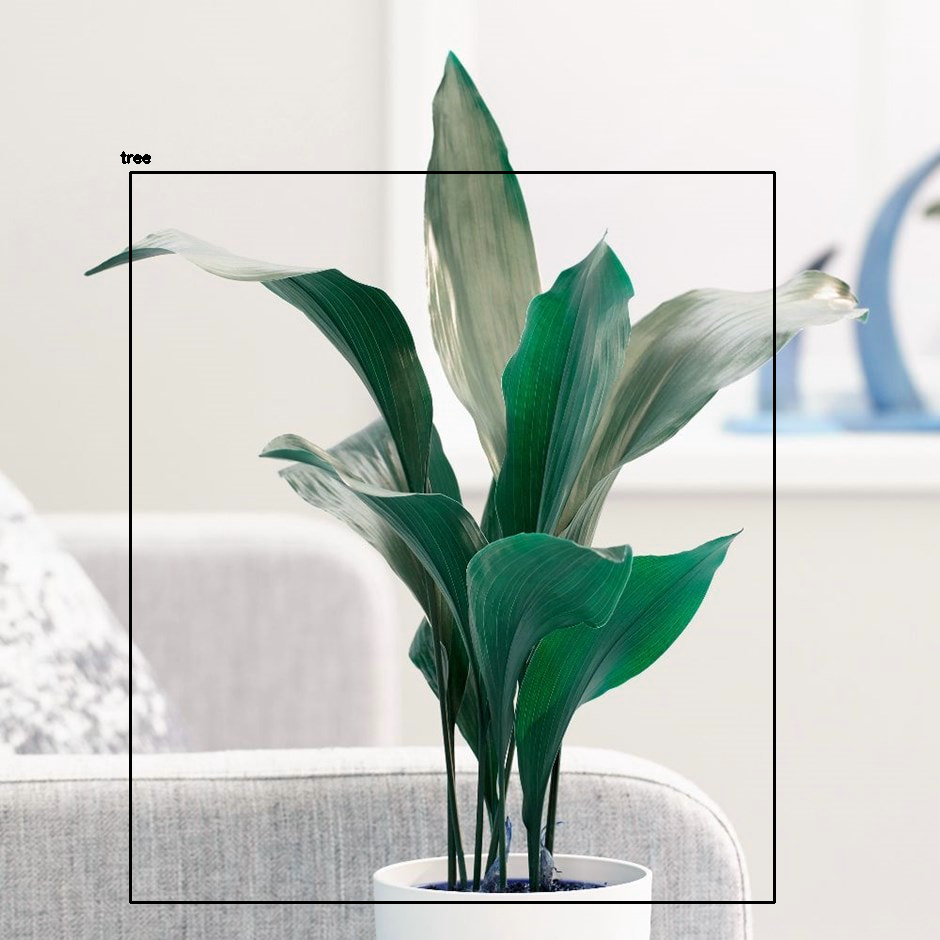

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import pandas as pd
import os

image = plt.imread('/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/test/pl2000032065.jpg')

classes = ['tree']


Width = image.shape[1]
Height = image.shape[0]

# read pre-trained model and config file
net = cv2.dnn.readNet("yolov3_custom_last.weights", "yolov3_testing.cfg")

# create input blob 
# set input blob for the network
net.setInput(cv2.dnn.blobFromImage(image, 0.00392, (416,416), (0,0,0), True, crop=False))


# run inference through the network
# and gather predictions from output layers
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
outs = net.forward(output_layers)

class_ids = []
confidences = []
boxes = []

#create bounding box 
for out in outs:
    for detection in out:
        scores = detection[5:]
        class_id = np.argmax(scores)
        confidence = scores[class_id]
        if confidence > 0.4:
            center_x = int(detection[0] * Width)
            center_y = int(detection[1] * Height)
            w = int(detection[2] * Width)
            h = int(detection[3] * Height)
            x = center_x - w / 2
            y = center_y - h / 2
            class_ids.append(class_id)
            confidences.append(float(confidence))
            boxes.append([x, y, w, h])

indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.1, 0.1)

#check if is people detection
for i in indices:
    i = i[0]
    box = boxes[i]
    if class_ids[i]==0:
        label = str(classes[class_id]) 
        cv2.rectangle(image, (round(box[0]),round(box[1])), (round(box[0]+box[2]),round(box[1]+box[3])), (0, 0, 0), 2)
        cv2.putText(image, label, (round(box[0])-10,round(box[1])-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 2)
        print(label)

cv2_imshow(image)

cv2.waitKey(0)
cv2.destroyAllWindows()

Our model has done a great job, we can now pass multipl images and get the bounding boxes for them as well

0
[[0]]


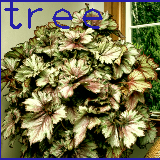

0
[[0]]


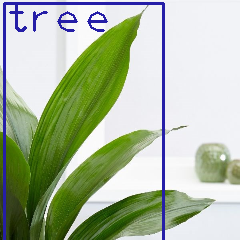

0
[[0]]


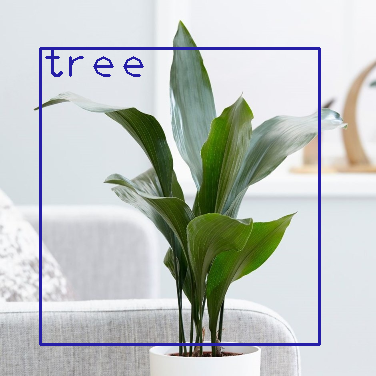

0
[[0]]


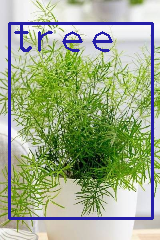

()


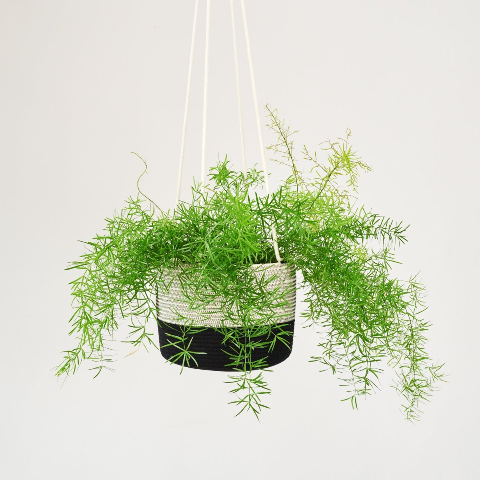

0
[[0]]


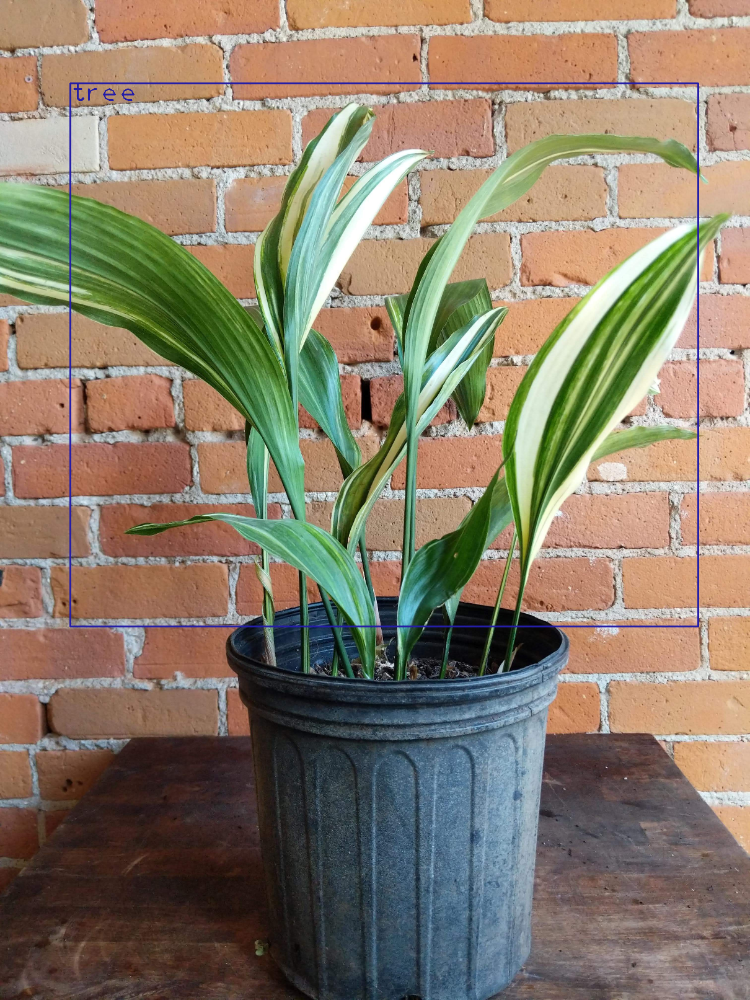

In [ ]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow


# Load Yolo
net = cv2.dnn.readNet("yolov3_custom_last.weights", "yolov3_testing.cfg")

# Name custom object
classes = ["tree"]

# Images path
images_path = glob.glob(r"/content/drive/MyDrive/ML_DL_Projects/yolo_custom_model_Training/test/*.jpg")



layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# Insert here the path of your images
random.shuffle(images_path)
# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    img = cv2.resize(img, None, fx=0.4, fy=0.4)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                # Object detected
                print(class_id)
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    print(indexes)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            color = colors[class_ids[i]]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
            cv2.putText(img, label, (x, y + 30), font, 3, color, 2)


    cv2_imshow(img)
    key = cv2.waitKey(0)

cv2.destroyAllWindows()



0
[[0]]


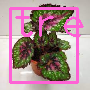

0
[[0]]


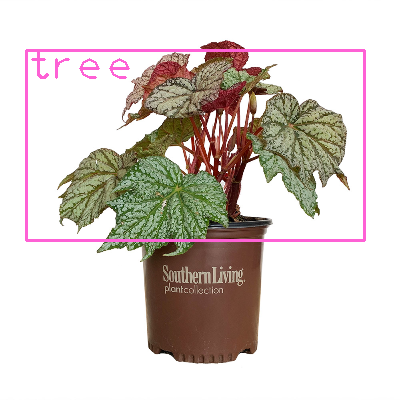

0
[[0]]


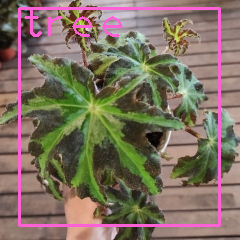

0
[[0]]


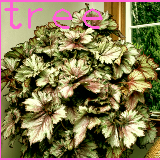

0
0
0
[[0]
 [1]
 [2]]


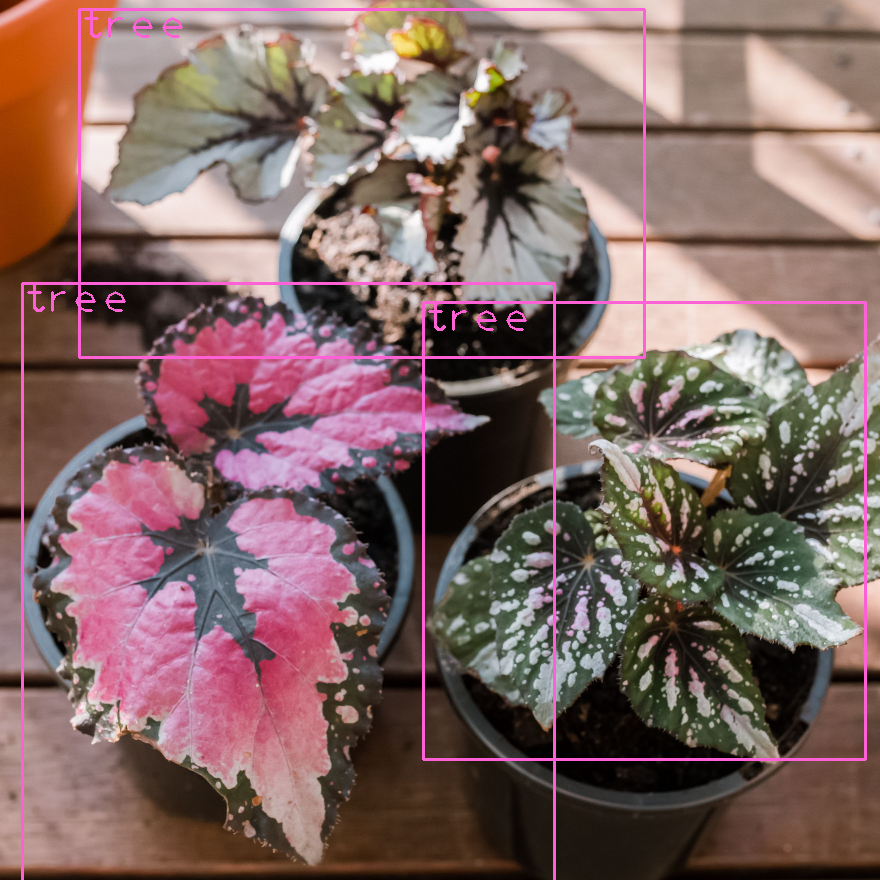

0
[[0]]


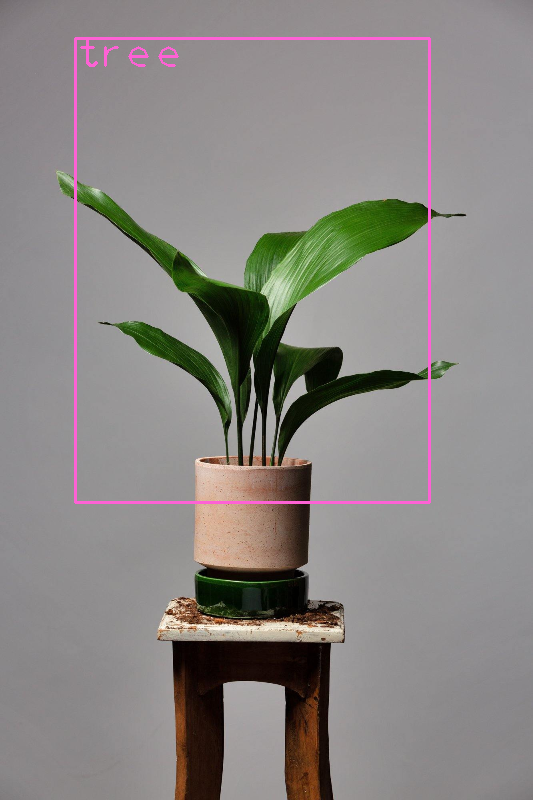

0
[[0]]


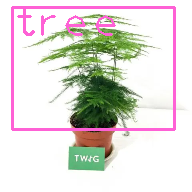

0
[[0]]


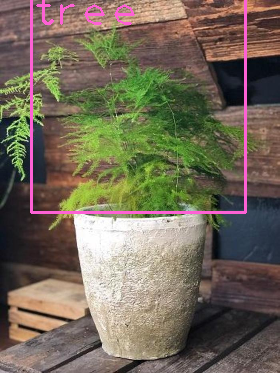

0
[[0]]


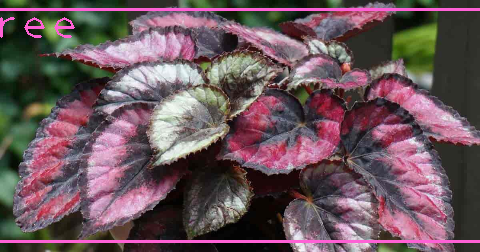

0
[[0]]


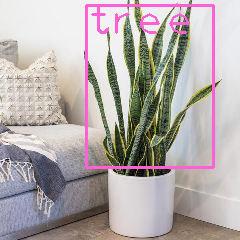

0
[[0]]


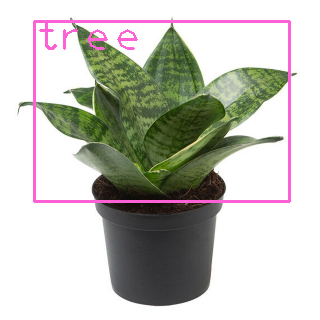

0
[[0]]


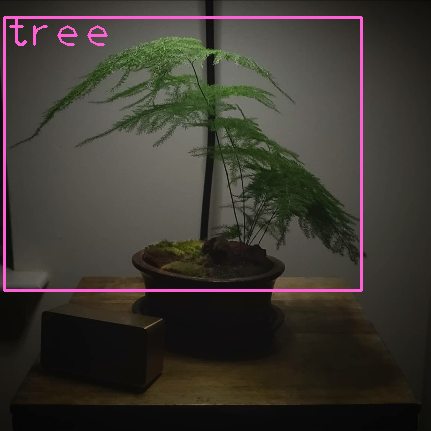

0
[[0]]


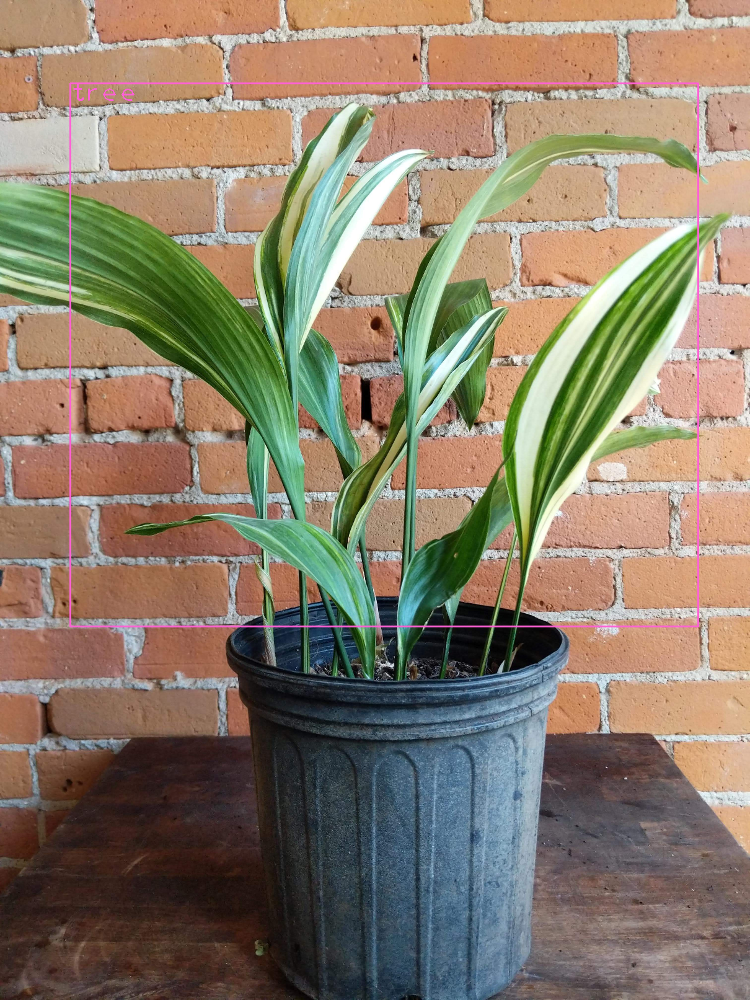

()


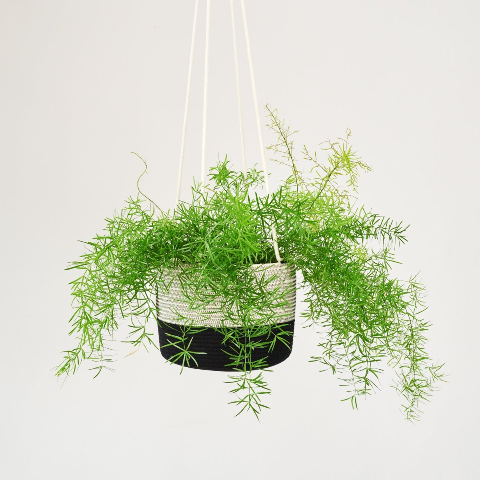

0
[[0]]


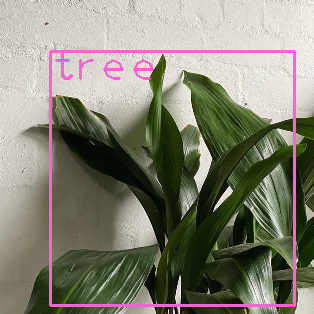

0
[[0]]


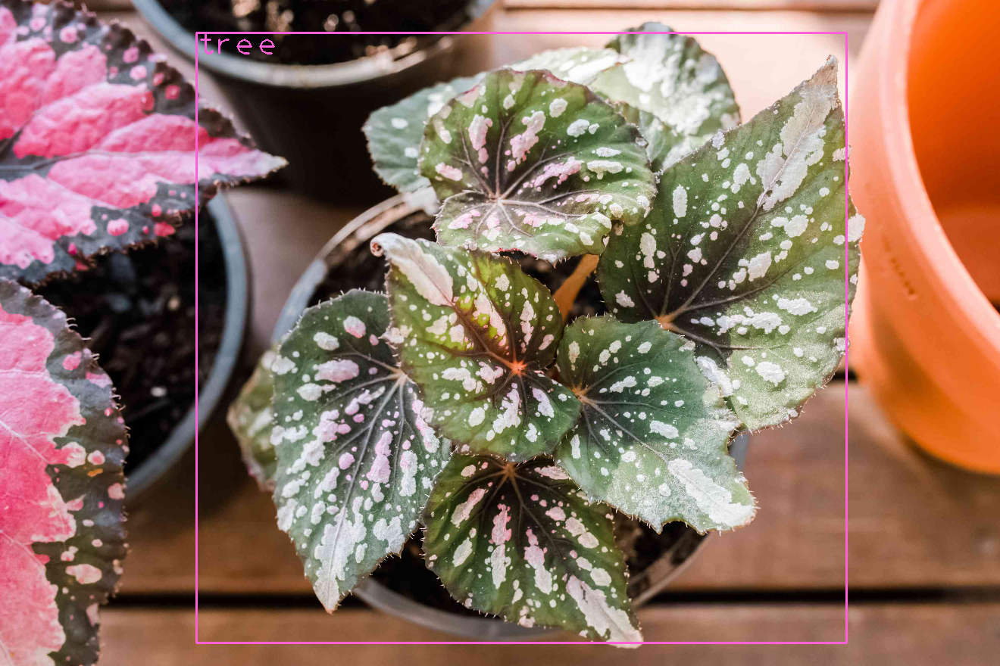

0
()


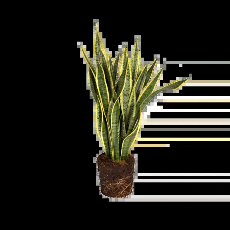

0
()


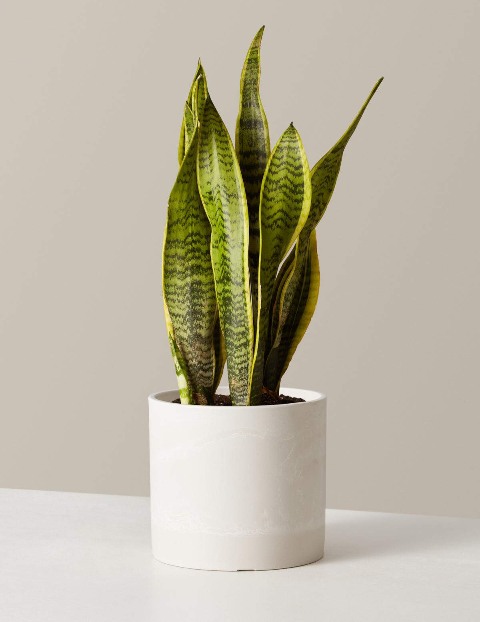

0
[[0]]


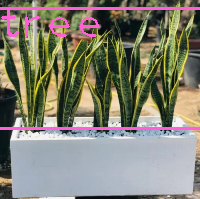

0
[[0]]


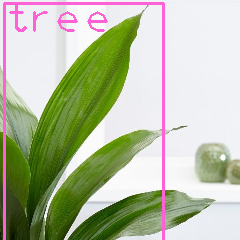

0
[[0]]


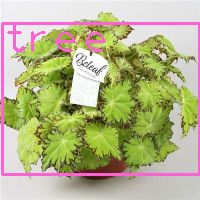

()


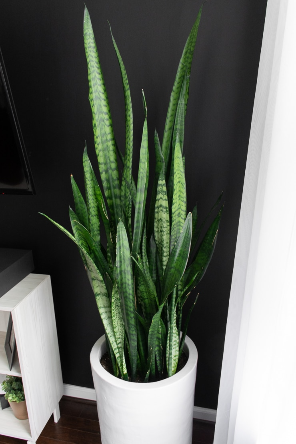

0
[[0]]


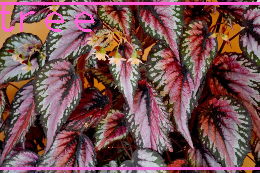

0
[[0]]


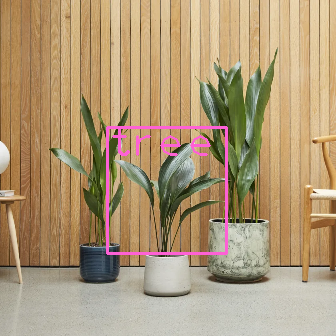

0
[[0]]


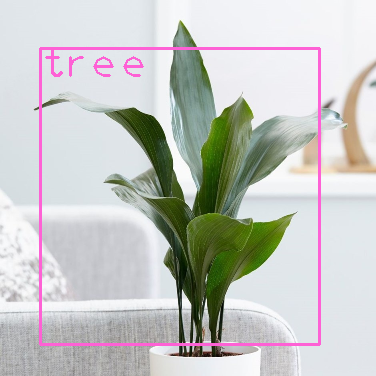

0
[[0]]


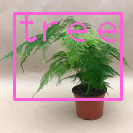

0
[[0]]


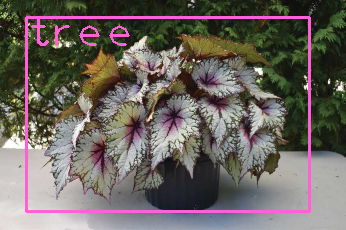

0
0
[[1]
 [0]]


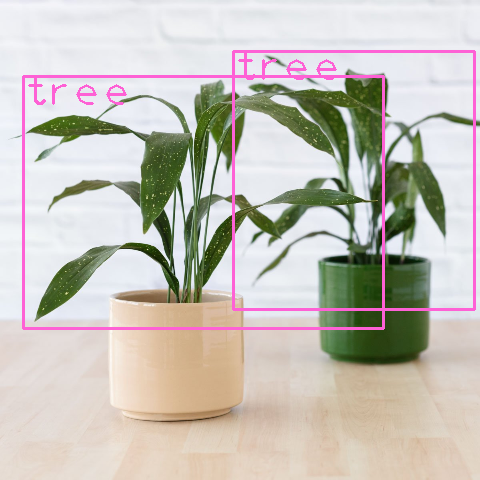

0
()


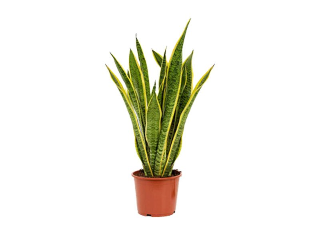

0
[[0]]


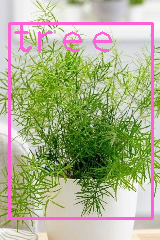

0
[[0]]


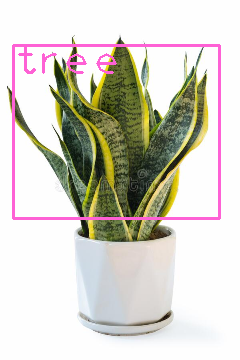

0
[[0]]


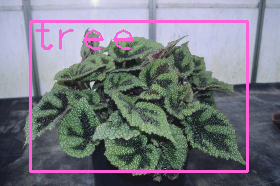

0
[[0]]


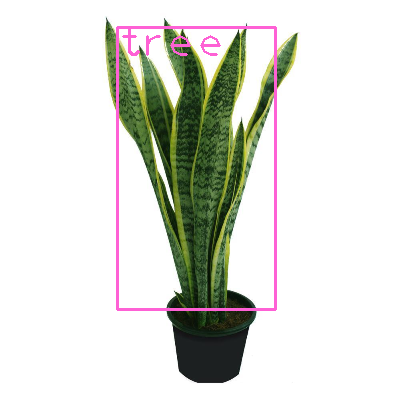

0
[[0]]


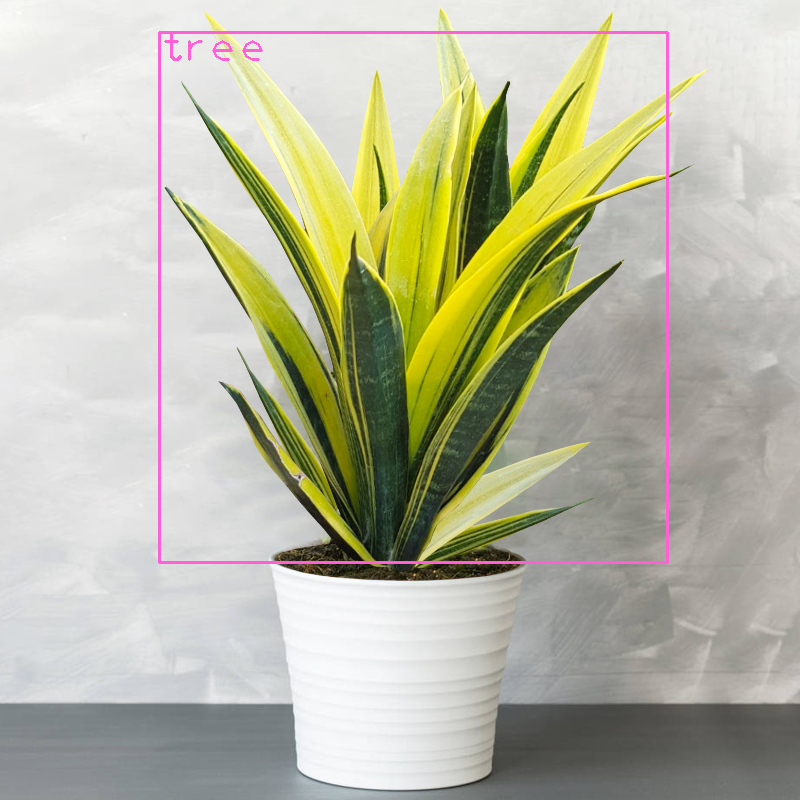

()


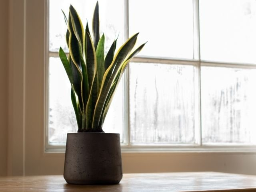

()


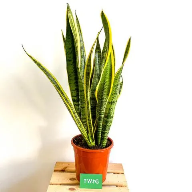

0
[[0]]


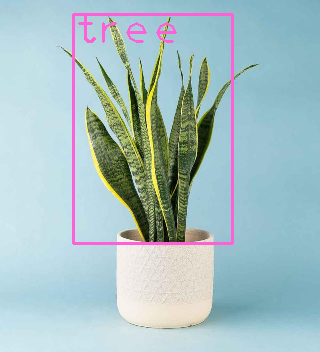

0
[[0]]


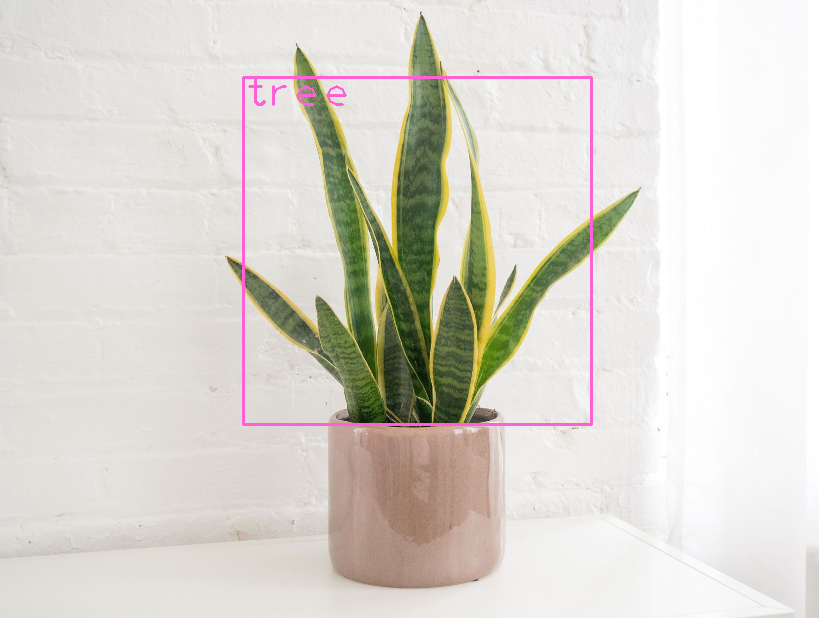

0
[[0]]


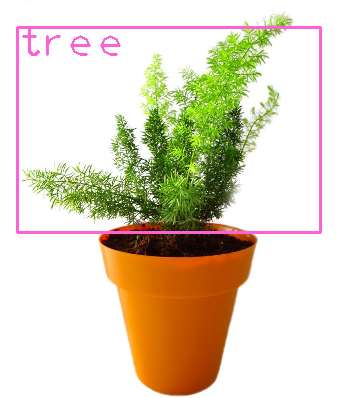

0
0
[[0]
 [1]]


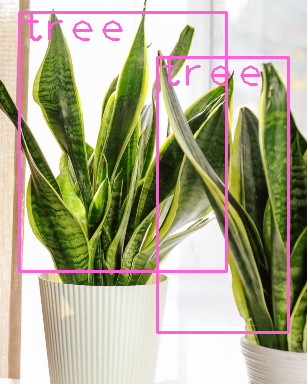

0
[[0]]


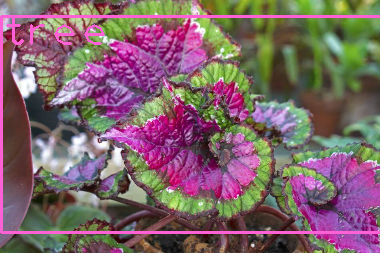

()


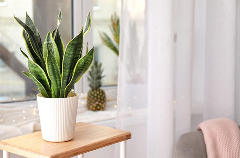

0
[[0]]


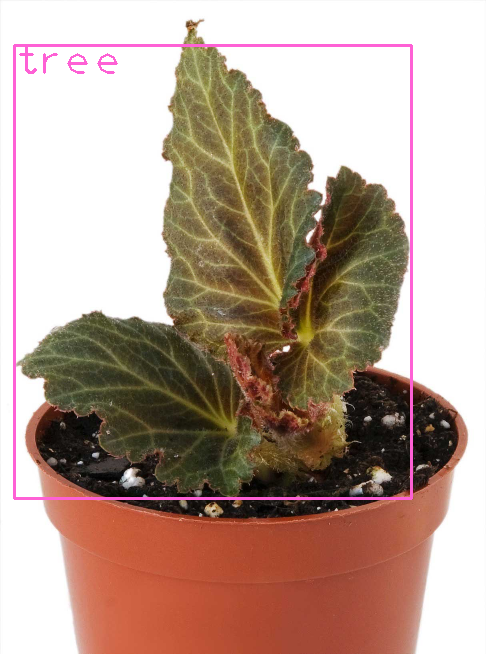

0
[[0]]


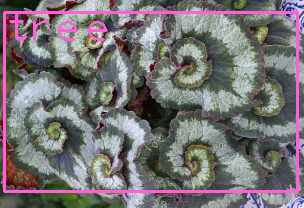

0
[[0]]


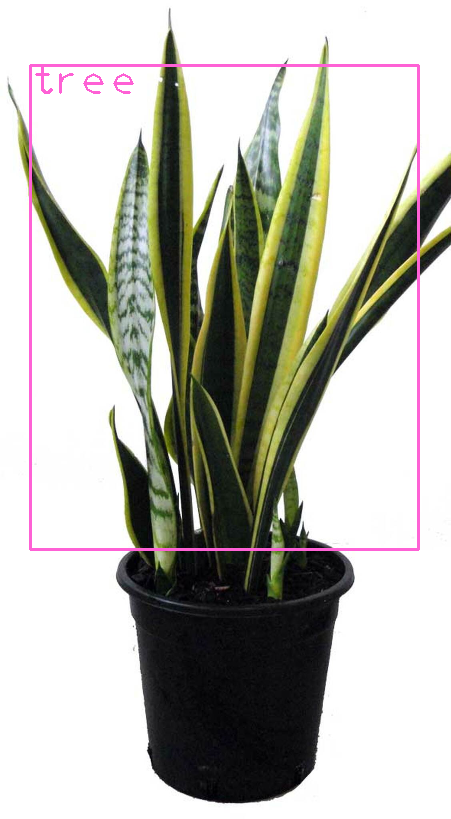

0
()


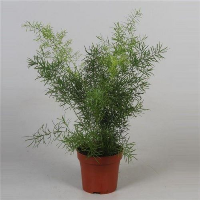

0
[[0]]


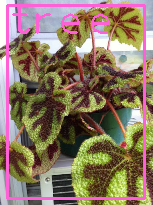

0
[[0]]


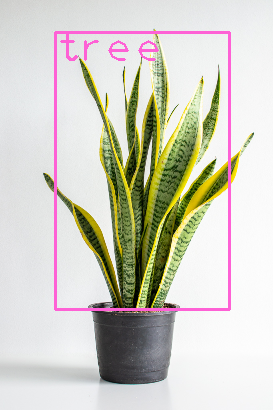

0
[[0]]


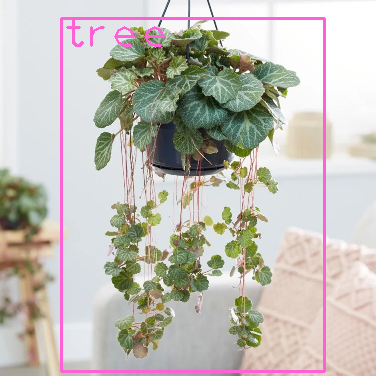

0
[[0]]


KeyboardInterrupt: ignored

### The model works perfectly on all the images provided, we can now also test it on a video file 

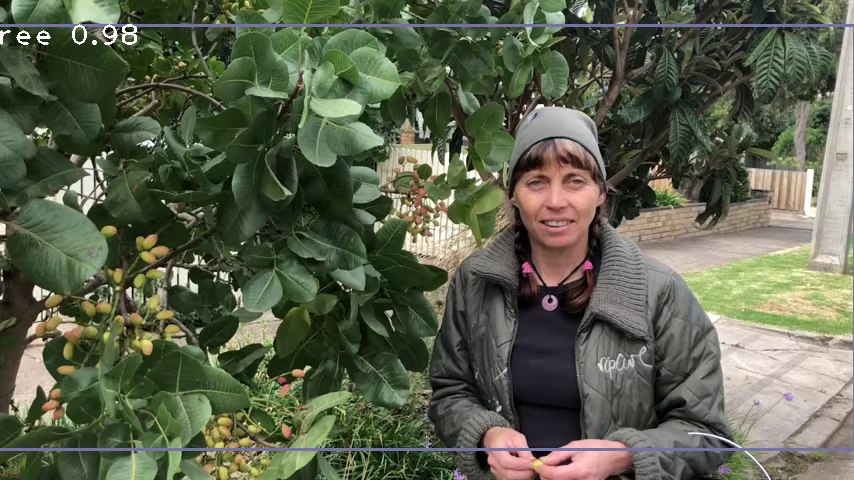

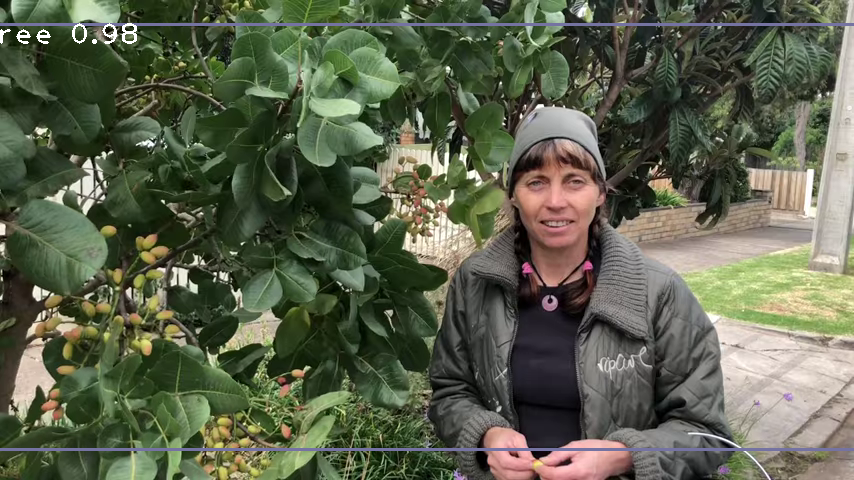

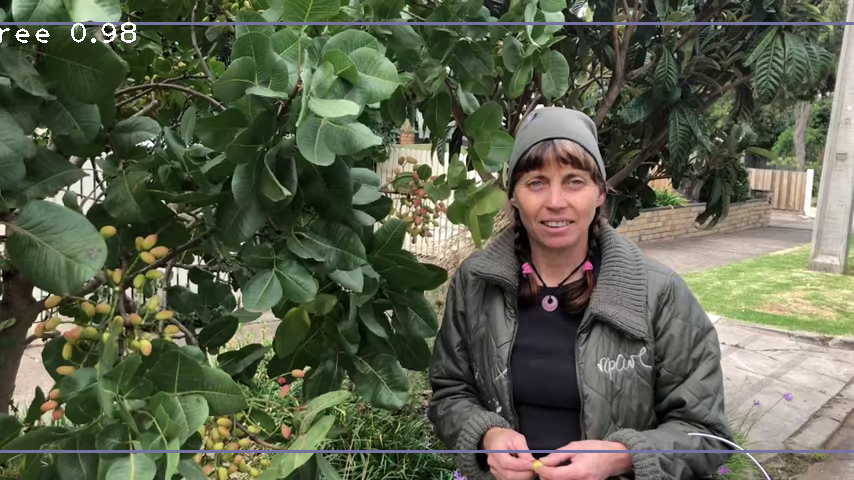

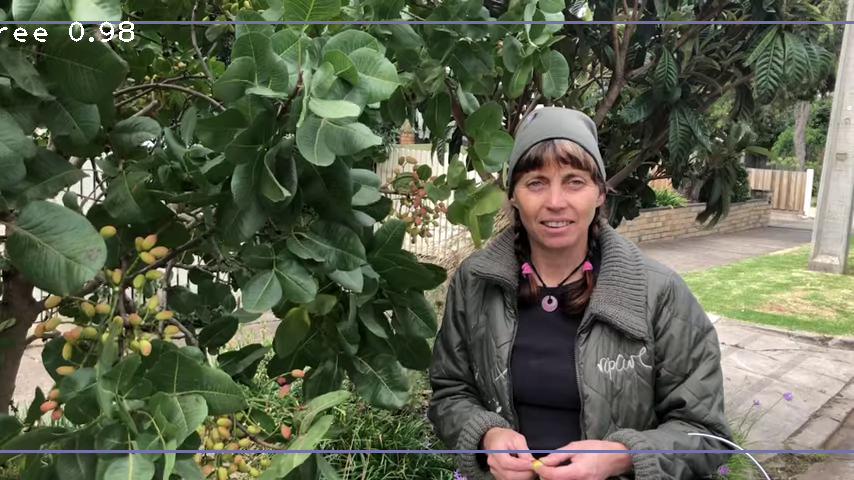

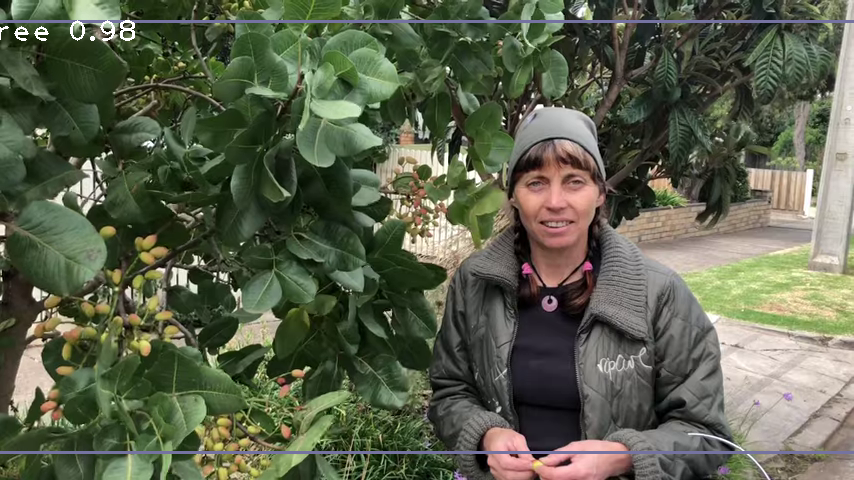

...

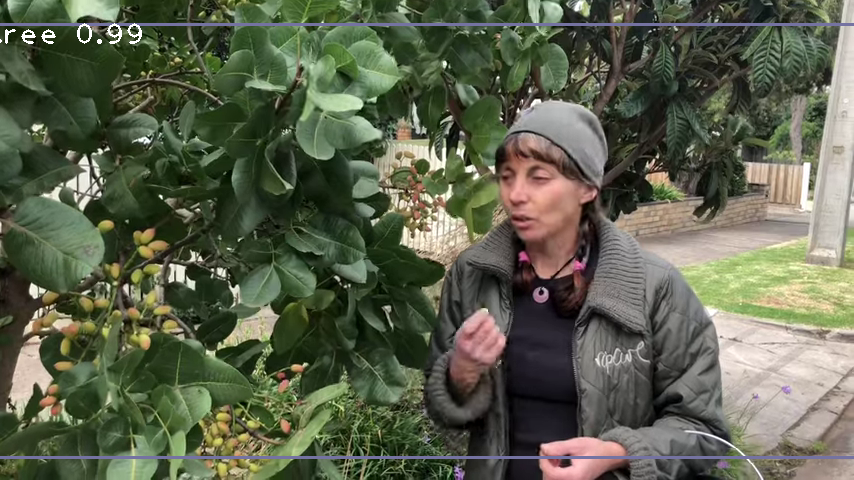

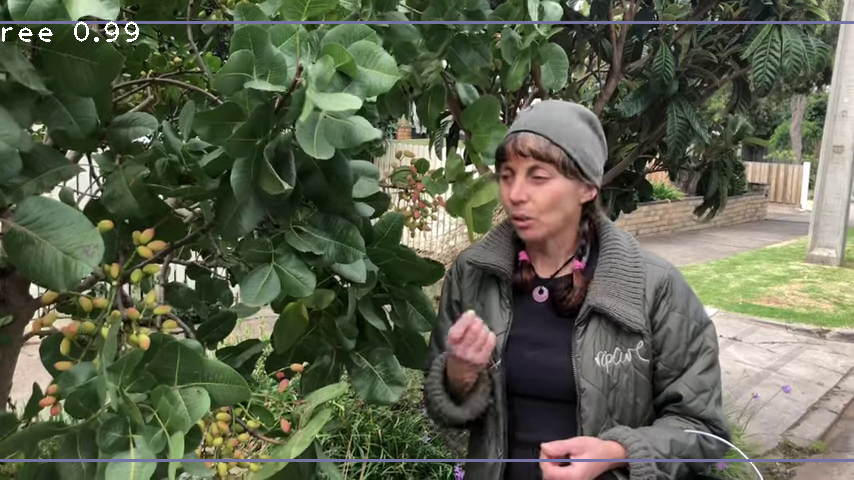

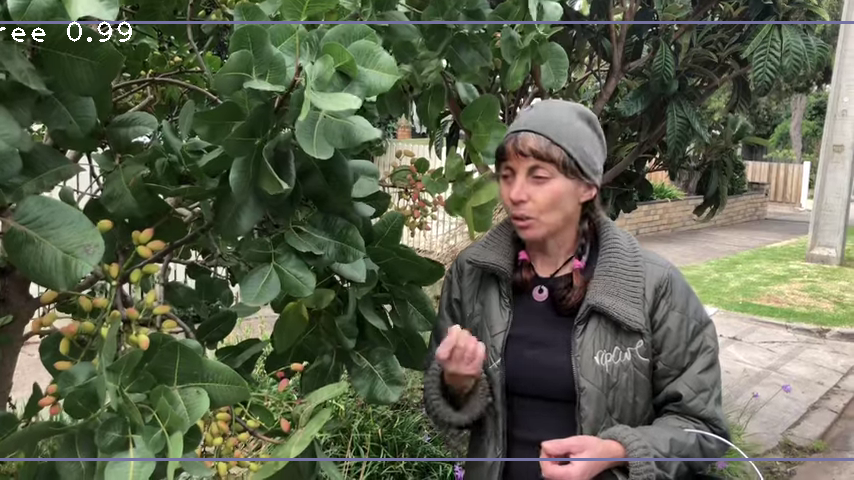

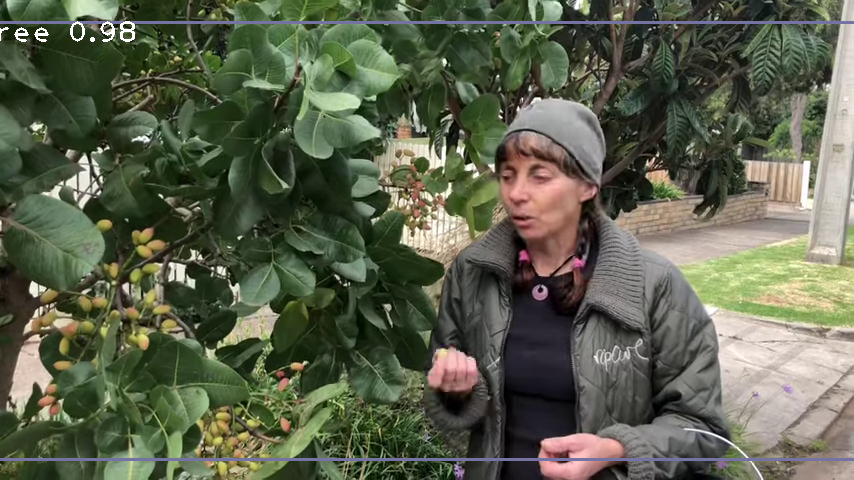

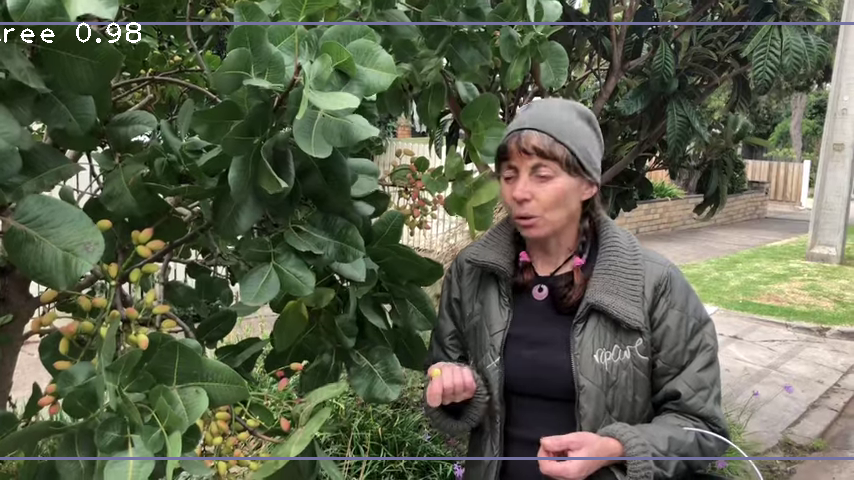

KeyboardInterrupt: ignored

In [ ]:
import cv2
import numpy as np

net = cv2.dnn.readNet("yolov3_custom_last.weights", "yolov3_testing.cfg")

classes = ['tree']

cap = cv2.VideoCapture('tree.mkv')
font = cv2.FONT_HERSHEY_PLAIN
colors = np.random.uniform(0, 255, size=(100, 3))

while True:
    _, img = cap.read()
    height, width, _ = img.shape

    blob = cv2.dnn.blobFromImage(img, 1/255, (416, 416), (0,0,0), swapRB=True, crop=False)
    net.setInput(blob)
    output_layers_names = net.getUnconnectedOutLayersNames()
    layerOutputs = net.forward(output_layers_names)

    boxes = []
    confidences = []
    class_ids = []

    for output in layerOutputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0]*width)
                center_y = int(detection[1]*height)
                w = int(detection[2]*width)
                h = int(detection[3]*height)

                x = int(center_x - w/2)
                y = int(center_y - h/2)

                boxes.append([x, y, w, h])
                confidences.append((float(confidence)))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.2, 0.4)

    if len(indexes)>0:
        for i in indexes.flatten():
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = str(round(confidences[i],2))
            color = colors[i]
            cv2.rectangle(img, (x,y), (x+w, y+h), color, 2)
            cv2.putText(img, label + " " + confidence, (x, y+20), font, 2, (255,255,255), 2)

    cv2_imshow(img)
    key = cv2.waitKey(1)
    if key==27:
        break

cap.release()
cv2.destroyAllWindows()

### Again the results are amazing the model could easily find a tree in the video and create a bounding box around it

# END